#  <font color=#F03415> Travel Salesman Problem (TSP) | Optimización | Heurística-Vecinos más Cercanos (NN) | Metaheurística- Recocido Simulado (SA) </font> 

- Bryan Alexander Urra Calfuñir
- Ing. Civil Industrial, M.Sc.Ingeniería Industrial.
- www.linkedin.com/in/bryanurracalfunir
- https://github.com/BryanUrra

## <font color=#F03415> Formulación Matemática del Problema </font> 
####  <font color=#F03415> Conjuntos </font> 

- Nodos ($I$): Conjunto de **nodos** 
- Nodos destino ($J$): Conjunto de **nodos destino** 


####  <font color=#F03415> Parámetros </font> 

- $d_{ij}$ = Distancia recorrida en kilómetros desde el nodo $i$ al nodo destino $j$


####  <font color=#F03415> Variables de decisión </font> 

- $x_{ij}$ = **1** si se decide viajar en el arco ${i,j}$ $\in Arcos$. **0** de otra manera.

- $u_{i}$ = variable continua, de orden en que se visitó al nodo $i$  $\in Nodos$.


####  <font color=#F03415> Función Objetivo y Restricciones </font> 

\begin{align}
Min && \sum_{{i,j} \ \in Arcos} x_{ij} * d_{ij} && && \\
s.a && \sum_{i\in I} x_{ij} = 1 && \forall j\in J &&(1)\\
&& \sum_{j\in J} x_{ij} = 1 && \forall i\in I &&(2)\\
&& (x_{ij} =1) >> (u_i +1 =u_j)&& \forall i,j\in Arcos &&(3) \\
&& x_{ij} \in \{0,1\} && \forall i\in I \ \forall j\in J &&(4)\\
&& u_i \geq 0  && \forall i\in I &&(5)\\
\end{align}

#  <font color=#F03415> Derivación computacional de la solución óptima </font> 

##  <font color=#F03415> Importar Librerías </font> 

In [1]:
#Librerías para realizar cálculos
import time
import numpy as np
import pandas as pd
from geopy import distance 

#Librerías para los gráficos
import matplotlib.pyplot as plt
from geopy import distance 
import folium 
from folium import features

#Optimización con Gurobi
from gurobipy import Model, GRB, quicksum

C:\Users\bryan\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\bryan\anaconda3\lib\site-packages\numpy\.libs\libopenblas.FB5AE2TYXYH2IJRDKGDGQ3XBKLKTF43H.gfortran-win_amd64.dll
C:\Users\bryan\anaconda3\lib\site-packages\numpy\.libs\libopenblas.WCDJNK7YVMPZQ2ME2ZZHJJRJ3JIKNDB7.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


##  <font color=#F03415> Creación de parámetros </font> 

In [2]:
resultados=[] #Lista para guardar resultados de la heurística, metaheurística y óptimo

In [3]:
#Semilla fija
np.random.seed(10)

#Conjuntos
c=15   #clientes
clientes=[j for j in range(c)]
arcos=[(i,j) for i in clientes for j in clientes if i!=j]
Nodos=[]
for n in clientes:
    if n>0:
        Nodos.append(clientes[n])
        
#Latitud y Longitud condicionados a la ciudad de La Serena,Chile.
x_clientes=list(np.random.random(c)*(-29.979466--28.950729)-29.950729)
y_clientes=list(np.random.random(c)*(-71.305824--70.215720)-70.215720)

#Parámetros
d={(i,j): np.hypot ((x_clientes[i]-x_clientes[j]),(x_clientes[i]-x_clientes[j])) for i,j in arcos}
#Distancia recorrida en kilómetros para atender al cliente 𝑖 a través de la planta 𝑗
distancia={(i,j):distance.distance((x_clientes[i],y_clientes[i]),(x_clientes[j],y_clientes[j])).km 
               for i in clientes for j in clientes if i!=j}


In [4]:
#Calcular la distancia de la ruta obtenida
def TotalDist(ruta):

    distancia_total=0
    for n in range(len(ruta)-1):
        i=ruta[n]
        j=ruta[n+1]    
        distancia_total+=distancia[(i,j)]
        
    return distancia_total

##  <font color=#F03415> Gráfico de situación actual  </font> 

In [5]:
mapa = folium.Map(location=[(-31.979466-28.950729)/2,(-71.305824-70.255720)/2],zoom_start=8)

fg=folium.FeatureGroup()  

fg.add_child(folium.CircleMarker(location=[x_clientes[0],y_clientes[0]],radius=7,
                                    color='green',fill = True,fill_color='green'))

fg.add_child(folium.Marker(location=[x_clientes[0],y_clientes[0]],
                        popup=folium.Popup(str(x_clientes[0])+str(y_clientes[0])),
                        icon=folium.Icon(color='green',
                                        icon_color='white',icon='home')))
for j in clientes:
    if j>0:
        fg.add_child(folium.CircleMarker(location=[x_clientes[j],y_clientes[j]],radius=3,
                                     color='red',fill = True,fill_color='#ff0000'))
        fg.add_child(folium.Marker(location=[x_clientes[j],y_clientes[j]],
                           popup=folium.Popup(str(x_clientes[j])+str(y_clientes[j])),
                           icon=folium.Icon(color='blue',
                                            icon_color='white',icon='info-sign')))
    
mapa.add_child(fg)
mapa

##  <font color=#F03415> Modelo matemático con Python y Gurobi </font> 

##  <font color=#F03415> Óptimo en Gurobi</font> 

In [6]:
start_time = time.time()
mdl=Model('TSP')

Academic license - for non-commercial use only - expires 2023-06-30
Using license file C:\Users\bryan\gurobi.lic


In [7]:
x=mdl.addVars(arcos,vtype=GRB.BINARY,name='x')
u=mdl.addVars(clientes,vtype=GRB.CONTINUOUS,name='u') 

obj=quicksum(distancia[i]*x[i] for i in arcos)
mdl.setObjective(obj,GRB.MINIMIZE)

Nodos=[]
for n in clientes:
    if n>0:
        Nodos.append(clientes[n])
        
mdl.addConstrs(quicksum(x[i, j] for j in clientes if j != i) == 1 for i in Nodos )
mdl.addConstrs(quicksum(x[i, j] for i in clientes if i != j) == 1 for j in Nodos)

mdl.addConstrs((x[i, j] == 1) >> (u[i]+1 == u[j]) for i, j in arcos if j != 0)

mdl.optimize()

Gurobi Optimizer version 9.1.2 build v9.1.2rc0 (win64)
Thread count: 4 physical cores, 8 logical processors, using up to 8 threads
Optimize a model with 28 rows, 225 columns and 392 nonzeros
Model fingerprint: 0x79ab6e0f
Model has 196 general constraints
Variable types: 15 continuous, 210 integer (210 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [5e+00, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Presolve added 196 rows and 196 columns
Presolve time: 0.01s
Presolved: 224 rows, 421 columns, 889 nonzeros
Presolved model has 196 SOS constraint(s)
Variable types: 211 continuous, 210 integer (210 binary)
Found heuristic solution: objective 1342.7384469

Root relaxation: objective 2.872622e+02, 25 iterations, 0.00 seconds

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0     0  287.26222    0   14 1342.73845  287.2

In [8]:
#Estado de la solución
end_time = time.time()
if mdl.status==2:
    print("El costo total del sistema de transporte es de $ ",str(round(mdl.objVal,4)))
    print()
    for v in mdl.getVars():
        if v.x>0:
            print(str(v.VarName)+"="+str(round(v.x,2)))
else:
    print("Solución Infactible")

El costo total del sistema de transporte es de $  338.7709

x[0,10]=1.0
x[1,8]=1.0
x[2,6]=1.0
x[3,11]=1.0
x[4,3]=1.0
x[5,13]=1.0
x[6,9]=1.0
x[7,2]=1.0
x[8,5]=1.0
x[9,12]=1.0
x[10,7]=1.0
x[11,14]=1.0
x[12,1]=1.0
x[13,4]=1.0
x[14,0]=1.0
u[1]=7.0
u[2]=3.0
u[3]=12.0
u[4]=11.0
u[5]=9.0
u[6]=4.0
u[7]=2.0
u[8]=8.0
u[9]=5.0
u[10]=1.0
u[11]=13.0
u[12]=6.0
u[13]=10.0
u[14]=14.0


In [9]:
#Crear listas con resultados obtenidos
arcos_activos=[k for k in arcos if x[k].x> 0.99] 
rutas=[]
for i in Nodos:
    if x[(0,i)].x > 0.9:
        aux=[0,i]
        while i!=0:
            j=i
            for k in clientes:
                if j!=k and x[(j,k)].x > 0.9:
                    aux.append(k)
                    i=k
        rutas.append(aux)

lista_rutas=[]
for i in range(len(rutas)):
    lista_rutas=rutas[i]
distanciaÓptima = round(TotalDist(lista_rutas),2)
tiempo_óptimo=round(end_time-start_time,4)
sinGAP=round(((distanciaÓptima-distanciaÓptima)/distanciaÓptima)*100,2)
SinGAP=(str(sinGAP)+'%')

In [10]:
#incorporar datos a la lista para el dataframe.
resultados.append(['Óptimo',distanciaÓptima,tiempo_óptimo,lista_rutas,SinGAP])

##  <font color=#F03415> Gráfico de solución óptima  </font> 

In [11]:
mapa = folium.Map(location=[(-31.479466-28.950729)/2,(-71.905824-70.555720)/2],zoom_start=10)

fg=folium.FeatureGroup()  

fg.add_child(folium.CircleMarker(location=[x_clientes[0],y_clientes[0]],radius=7,
                                    color='green',fill = True,fill_color='green'))

fg.add_child(folium.Marker(location=[x_clientes[0],y_clientes[0]],
                        popup=folium.Popup(str(x_clientes[0])+str(y_clientes[0])),
                        icon=folium.Icon(color='green',
                                        icon_color='white',icon='home')))
for j in clientes:
    if j>0:
        fg.add_child(folium.CircleMarker(location=[x_clientes[j],y_clientes[j]],radius=3,
                                     color='red',fill = True,fill_color='#ff0000'))
        fg.add_child(folium.Marker(location=[x_clientes[j],y_clientes[j]],
                           popup=folium.Popup(str(x_clientes[j])+str(y_clientes[j])),
                           icon=folium.Icon(color='blue',
                                            icon_color='white',icon='info-sign')))
for i,j in arcos_activos:  
    my_PolyLine = folium.PolyLine([(x_clientes[i],y_clientes[i]),
                                  (x_clientes[j],y_clientes[j])], 
                                  color='blue', weight=2.5, opacity=1).add_to(mapa)
                                  
    mapa.add_child(my_PolyLine)
    
mapa.add_child(fg)
mapa

##  <font color=#F03415> Heurística del Vecino más cercano </font> 
#### Basado en el video de Sergio Correa: https://www.youtube.com/watch?v=vKRgagilzT8&t=686s

In [12]:
inicio_heurística = time.time()
start_node=0
NN=[start_node]   #Seleccionar nodo de partida (planta)

while len(NN)<len(clientes):
    k=NN[-1]
    nn={(k,j):d[(k,j)] for j in clientes if j!=k and j not in NN }
    new = min(nn.items(),key=lambda x:x[1])
    NN.append(int(new[0][1]))
NN.append(start_node)

distanciaHeurística=round(TotalDist(NN),2)
gap_he=round(((distanciaHeurística-distanciaÓptima)/distanciaÓptima)*100,2)
gap_h=(str(gap_he)+'%')
final_heurística = time.time()
tiempo_heurística = round(final_heurística - inicio_heurística,4) 

In [13]:
#incorporar datos a la lista para el dataframe.
resultados.append(['Heurística',distanciaHeurística,tiempo_heurística,NN,gap_h])

##  <font color=#F03415> Metaheurística Recocido Simulado </font>
#### Desarrollado por Bryan Urra

In [14]:
#Codificación de metaheurística para almacenar datos
def Metaheurística(semilla,cant_iteraciones,alpha,aceptaciones,temperatura):
       
    np.random.seed(semilla)
    inicio_Metaheurística = time.time()

    x0= []
    for a in range(len(NN)):
        x0.append(NN[a])

    distanciaInicial = TotalDist(NN)

    """
    #Parámetros de Recocido Simulado
    """
    N = cant_iteraciones  #Cantidad de iteraciones a buscar en vecindario
    alfa = alpha #Programa de reducción de temperatura
    acept= aceptaciones #Cantidad de iteraciones de aceptación sin reducción de temperatura
    T0 = temperatura*distanciaInicial #Temperatura inicial es el 90% de la distancia inicial
    T=T0
    a=0 #contador de iteraciones de aceptación a la temperatura actual

    Temp = []
    Min_Cost = []
    nodos=[]

    """
    #Recocido simulado
    """

    for i in range(N):
        for j in range(acept):
            ran_1 = np.random.randint(1,len(x0)-1)
            ran_2 = np.random.randint(1,len(x0)-1)

            while ran_1==ran_2 :
                ran_2 = np.random.randint(1,len(x0)-1)

            xt=[]
            A1=x0[ran_1]
            A2=x0[ran_2]

            w=0
            for x in x0:
                if x0[w]==A1:
                    xt=np.append(xt,A2)
                elif x0[w]==A2:
                    xt = np.append(xt,A1)
                else:
                    xt=np.append(xt,x0[w])
                w = w+1

            distanciaFinal = TotalDist(xt) 

            rand_a=np.random.rand()
            form = 1/(np.exp(distanciaFinal-distanciaInicial)/T0)

            if distanciaFinal<=distanciaInicial:
                x0=xt
                nodos.append(xt)
                a=a+1 #Actualizar contador de soluciones aceptadas para programa de reducción de T°
                Min_Cost.append(distanciaFinal)
                Temp.append(round(T,1))

            elif rand_a<=form:
                x0=xt
                nodos.append(xt)
                a=a+1 #Actualizar contador de soluciones aceptadas para programa de reducción de T°
                Min_Cost.append(distanciaFinal)
                Temp.append(round(T,1))

            else:
                x0=x0

            if a==acept: #Una vez alcance las soluciones aceptadas, la temperatura disminuirá
                T=alfa*T
                a=0

    Dist_min=min(Min_Cost)
    nodo=[]
    z=[]
    nodo.append(x0) #agregar ruta de heurística

    for i in range (len(Min_Cost)):
        #Agregar ruta con la mejor F.O
        a=[]
        if Min_Cost[i]==Dist_min:
            nodo=nodos[i]
            a=nodos[i]

        #Agregar rutas múltiples con la misma F.O
        if list(a) not in z:
            z.append(list(a))   

    #eliminar lista vacía y dejar solo rutas alternativas en caso de múltiples soluciones
    y=[]
    for i in range(len(z)):
        if i >0:
            y.append(z[i])   

    #Obtener ruta en forma de lista entera (se modifica el array y luego el float)

    o=nodo.tolist() #cambiar array a lista
    ruta_final=[] #obtener solo valores enteros

    for i in range(len(o)):
        ruta_final.append(int(o[i]))

    distanciaMeta = round(TotalDist(ruta_final),2)

    final_Metaheurística=time.time()
    tiempo_Metaheurística = round(final_Metaheurística-inicio_Metaheurística,4)
    
    return [distanciaMeta,tiempo_Metaheurística,ruta_final]

In [15]:
#Gráfico para almacenar soluciones obtenidas de la metaheurística
def gráfico(ruta):
    
    fig = plt.figure(figsize=(18,12))
    
    ax = fig.add_subplot(121)

    plt.scatter(x_clientes,y_clientes,color='black')
    for c in range(len(lista_rutas)-1):
        plt.plot([x_clientes[lista_rutas[c]], x_clientes[lista_rutas[c+1]]],
                [y_clientes[lista_rutas[c]], y_clientes[lista_rutas[c+1]]],color='green')


    plt.scatter(x_clientes[0], y_clientes[0],color='blue',marker='D')
    plt.annotate("DC", (x_clientes[0], y_clientes[0]))

    for n in range(len(x_clientes)):
        plt.annotate(str(n), xy=(x_clientes[n], y_clientes[n]),
                     xytext=(x_clientes[n]-0.02, y_clientes[n]-0.02),color='red')


    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.title('Ruta Óptima')
    
    ax = fig.add_subplot(122)

    plt.scatter(x_clientes,y_clientes,color='black')
    for c in range(len(ruta)-1):
        plt.plot([x_clientes[ruta[c]], x_clientes[ruta[c+1]]],
                [y_clientes[ruta[c]], y_clientes[ruta[c+1]]],color='orange')


    plt.scatter(x_clientes[0], y_clientes[0],color='blue',marker='D')
    plt.annotate("DC", (x_clientes[0], y_clientes[0]))

    for n in range(len(x_clientes)):
        plt.annotate(str(n), xy=(x_clientes[n], y_clientes[n]),
                     xytext=(x_clientes[n]-0.02, y_clientes[n]-0.02),color='red')

    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.title('Metaheurística Recocido Simulado')

    plt.tight_layout()
    
    return fig

##  <font color=#F03415> Almacenar resultados con distinos números aleatorios</font> 

In [16]:
semillas=[j for j in range(300)]

for j in range(len(semillas)):    

    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
    l=Metaheurística(semillas[j],100,0.85,20,0.7)

    distanciaMeta=l[0]
    
    tiempo_Metaheurística=l[1]
    ruta_final=l[2]
    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
    gap=(str(gap_m)+'%')
       
    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])
    

In [17]:
#cant_iteraciones=[]

#valor=10
#for i in range(50):
#    cant_iteraciones.append(valor)
#    valor+=10 

#for j in range(len(cant_iteraciones)):    

#    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
#    l=Metaheurística(9,cant_iteraciones[j],0.9,10,0.9)

#    distanciaMeta=l[0]
#    tiempo_Metaheurística=l[1]
#    ruta_final=l[2]
#    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
#    gap=(str(gap_m)+'%')
       
#    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])

In [18]:
#Alfas=[]

#valor=0.5
#for i in range(50):
#    Alfas.append(valor)
#    valor+=0.01

#for j in range(len(Alfas)):    

    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
#    l=Metaheurística(9,100,Alfas[j],10,0.9)

#    distanciaMeta=l[0]
#    tiempo_Metaheurística=l[1]
#    ruta_final=l[2]
#    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
#    gap=(str(gap_m)+'%')
       
#    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])

In [19]:
#Aceptaciones=[]

#valor=10
#for i in range(50):
#    Aceptaciones.append(valor)
#    valor+=10 


#for j in range(len(Aceptaciones)):    

#    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
#    l=Metaheurística(9,100,0.9,Aceptaciones[j],0.9)

#    distanciaMeta=l[0]
#    tiempo_Metaheurística=l[1]
#    ruta_final=l[2]
#    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
#    gap=(str(gap_m)+'%')
       
#    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])

In [20]:
#TEMPERATURAS=[]

#valor=0.5
#for i in range(50):
#    TEMPERATURAS.append(valor)
#    valor+=0.01

#for j in range(len(TEMPERATURAS)):    

#    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
#    l=Metaheurística(9,100,0.9,43,TEMPERATURAS[j])

#    distanciaMeta=l[0]
#    tiempo_Metaheurística=l[1]
#    ruta_final=l[2]
#    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
#    gap=(str(gap_m)+'%')
       
#    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])

In [21]:
semillasPRO=[j for j in range(100)]

for j in range(len(semillasPRO)):    

    #Metaheurística(semillas,cant_iteraciones,alpha,aceptaciones,temperatura)
    l=Metaheurística(semillasPRO[j],100,0.64,43,0.56)

    distanciaMeta=l[0]
    tiempo_Metaheurística=l[1]
    ruta_final=l[2]
    gap_m=round(((distanciaMeta-distanciaÓptima)/distanciaÓptima)*100,2)
    gap=(str(gap_m)+'%')
       
    resultados.append(['Metaheurística iteración: '+str(j+1)+' ',distanciaMeta,tiempo_Metaheurística,ruta_final,gap])

##  <font color=#F03415> Análisis de resultados</font> 

In [22]:
new_df=pd.DataFrame(resultados,columns=['Modelo','Función Objetivo','Tiempo computacional (segundos)','Ruta','GAP (%)'])
new_df.sort_values(by='Función Objetivo',ascending=True,inplace=True)
new_df.set_index('Modelo',inplace=True)
new_df

,Función Objetivo,Tiempo computacional (segundos),Ruta,GAP (%)
Modelo,,,,
Óptimo,338.77,0.4019,"[0, 10, 7, 2, 6, 9, 12, 1, 8, 5, 13, 4, 3, 11,...",0.0%
Metaheurística iteración: 96,350.01,0.4797,"[0, 11, 7, 10, 2, 6, 9, 12, 1, 8, 5, 13, 4, 3,...",3.32%
Metaheurística iteración: 82,368.27,0.6176,"[0, 11, 14, 7, 10, 2, 6, 9, 12, 8, 1, 5, 13, 4...",8.71%
Metaheurística iteración: 80,370.06,0.2492,"[0, 3, 11, 10, 7, 2, 6, 9, 12, 1, 8, 5, 4, 13,...",9.24%
Metaheurística iteración: 240,380.04,0.3301,"[0, 14, 11, 3, 4, 13, 5, 6, 9, 12, 1, 8, 2, 7,...",12.18%
...,...,...,...,...
Metaheurística iteración: 46,448.52,0.2656,"[0, 14, 2, 10, 7, 6, 8, 1, 9, 5, 12, 13, 4, 3,...",32.4%
Metaheurística iteración: 38,449.45,0.2176,"[0, 10, 2, 7, 11, 4, 13, 5, 6, 9, 12, 1, 8, 14...",32.67%
Metaheurística iteración: 183,451.36,0.2297,"[0, 10, 2, 7, 4, 13, 8, 1, 5, 9, 12, 6, 11, 14...",33.23%


##  <font color=#F03415> Exportar gráfico y Excel</font> 

In [23]:
#Exportar dataframe con los resultados de las iteraciones
new_df.to_excel('C:/Users/bryan/Desktop/TSP/Iteraciones/Metaheurística.xlsx')

C:\Users\bryan\AppData\Local\Temp\ipykernel_2488\223555003.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(18,12))


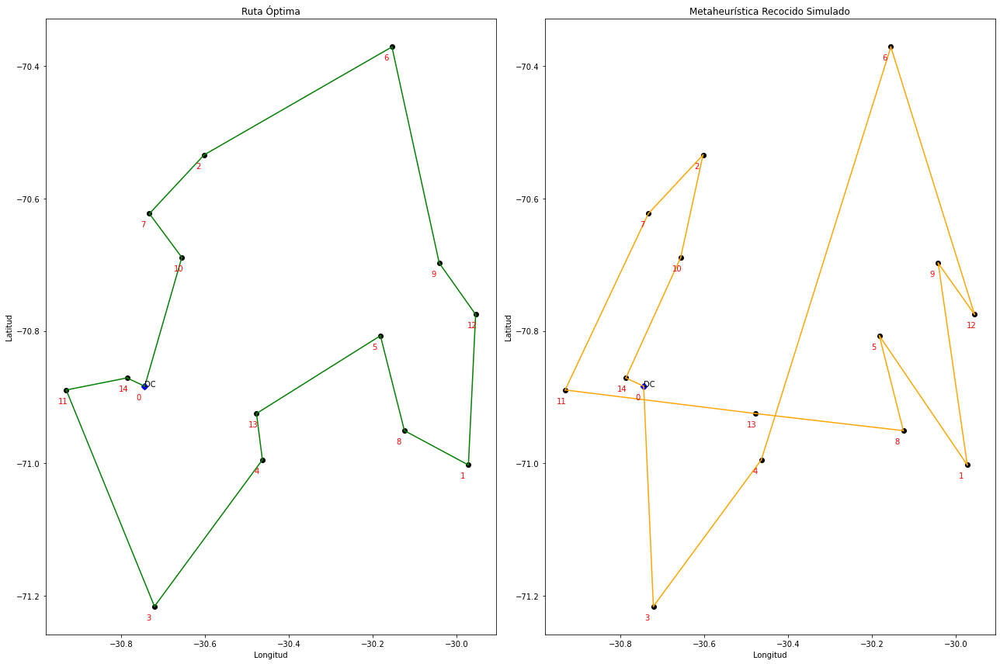

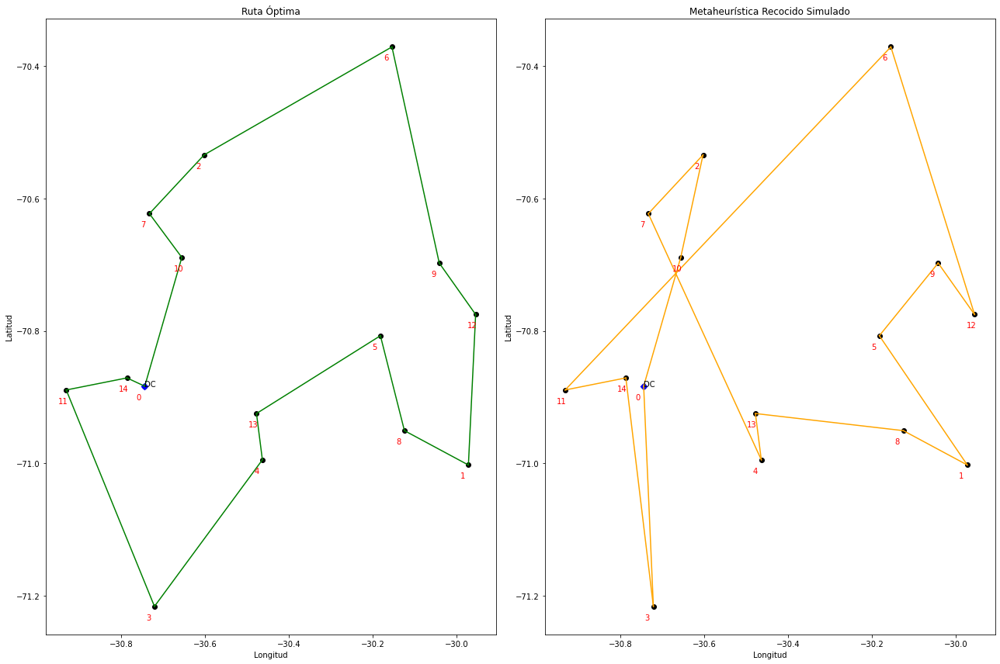

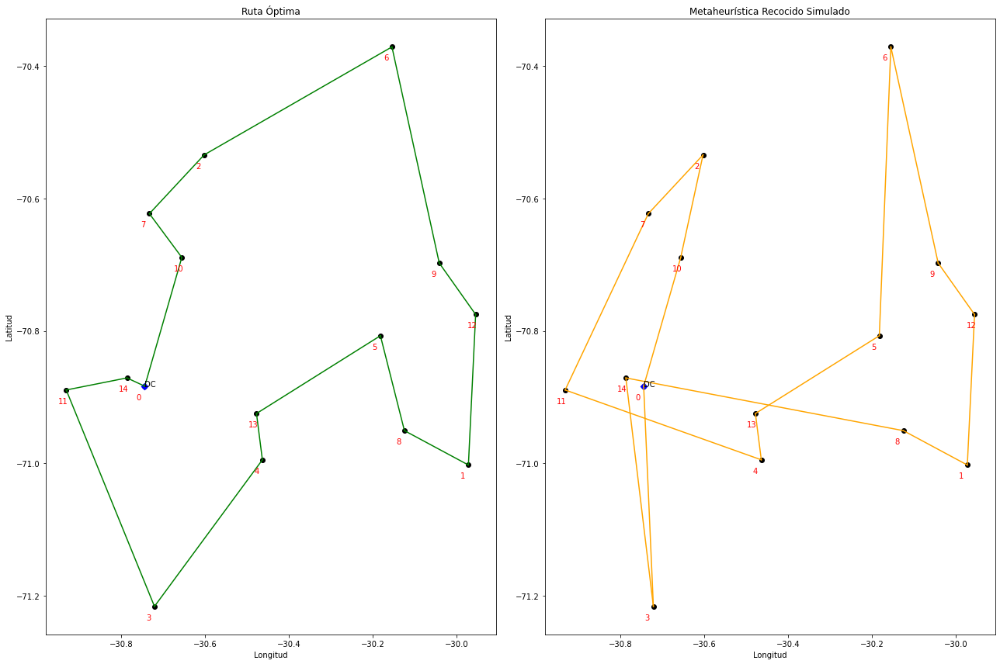

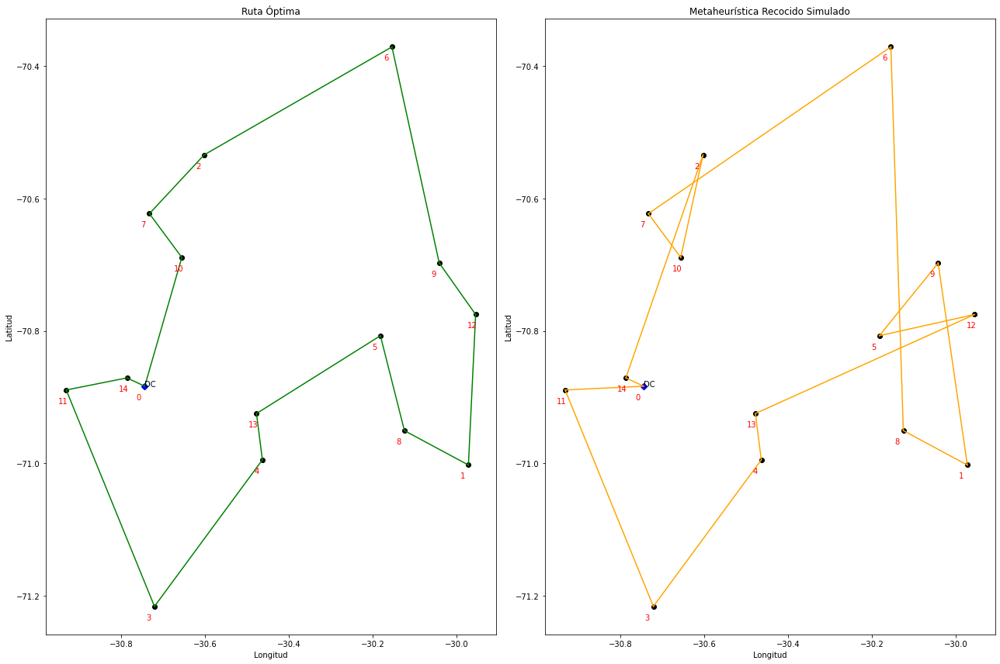

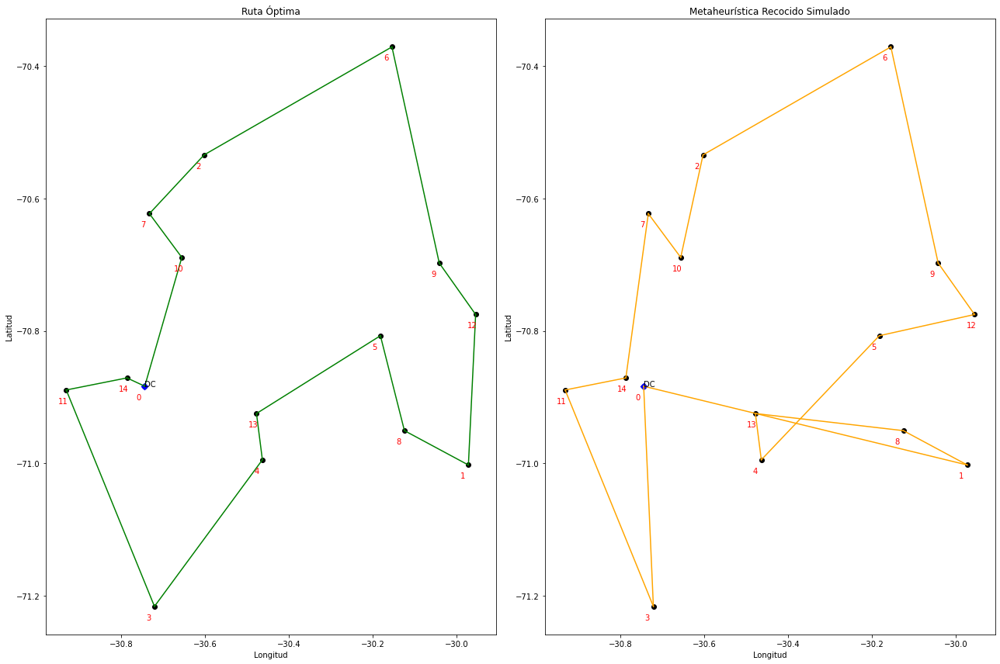

...

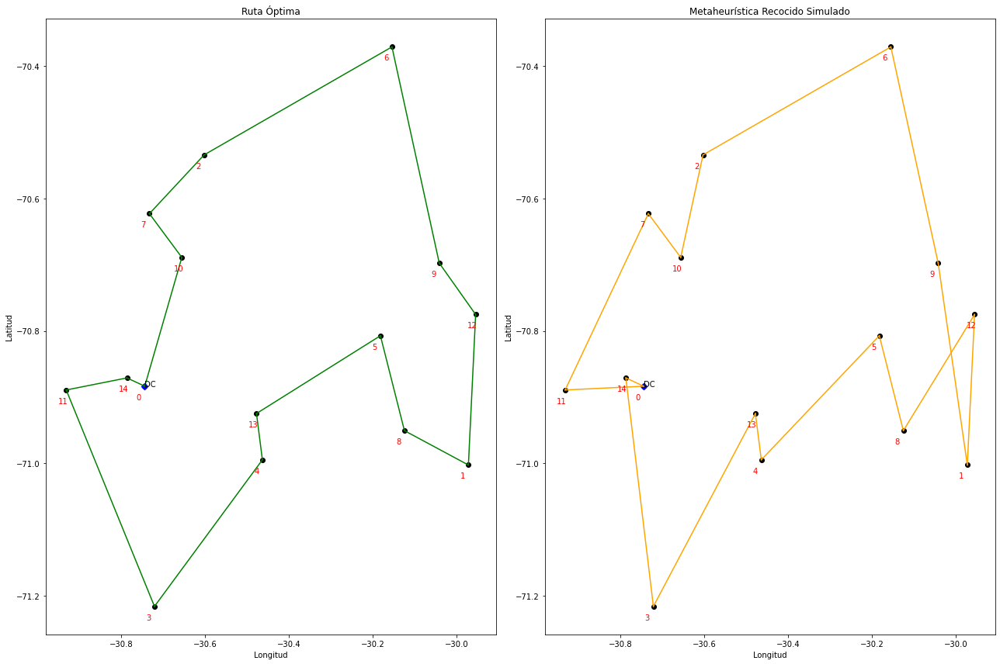

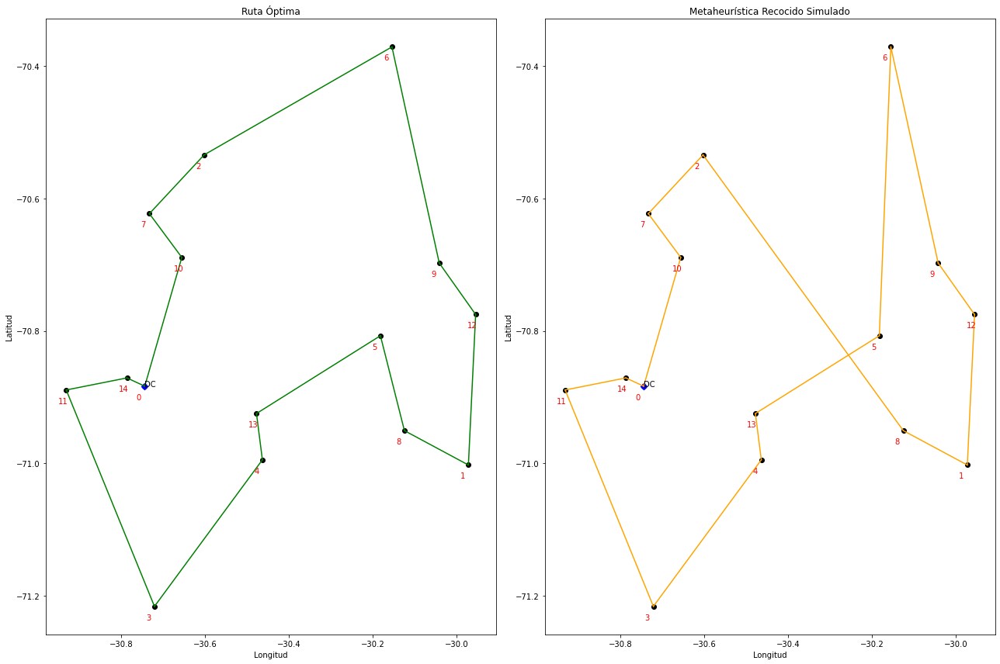

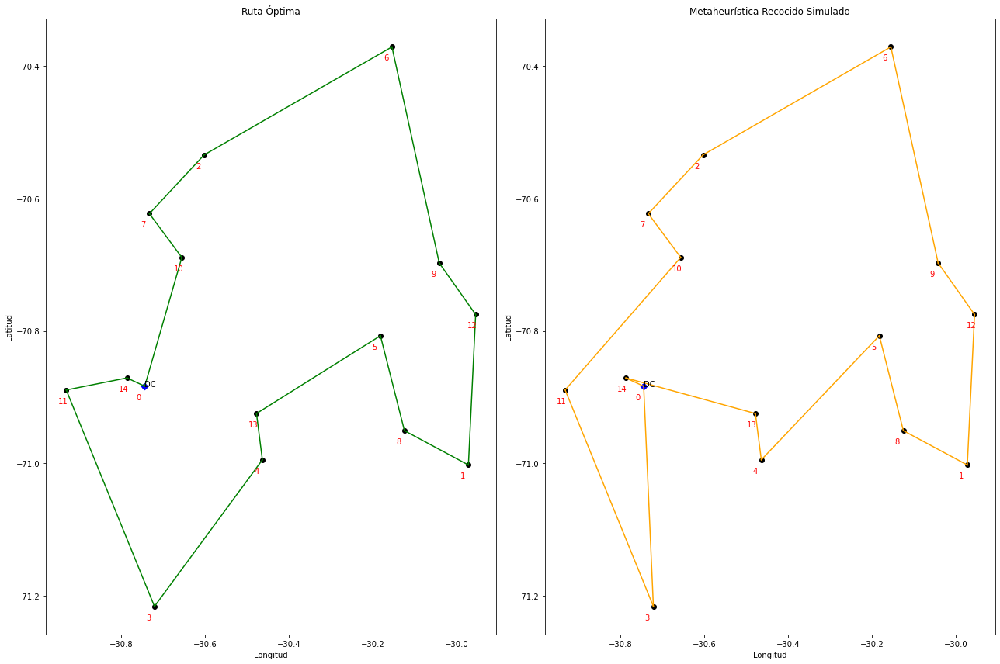

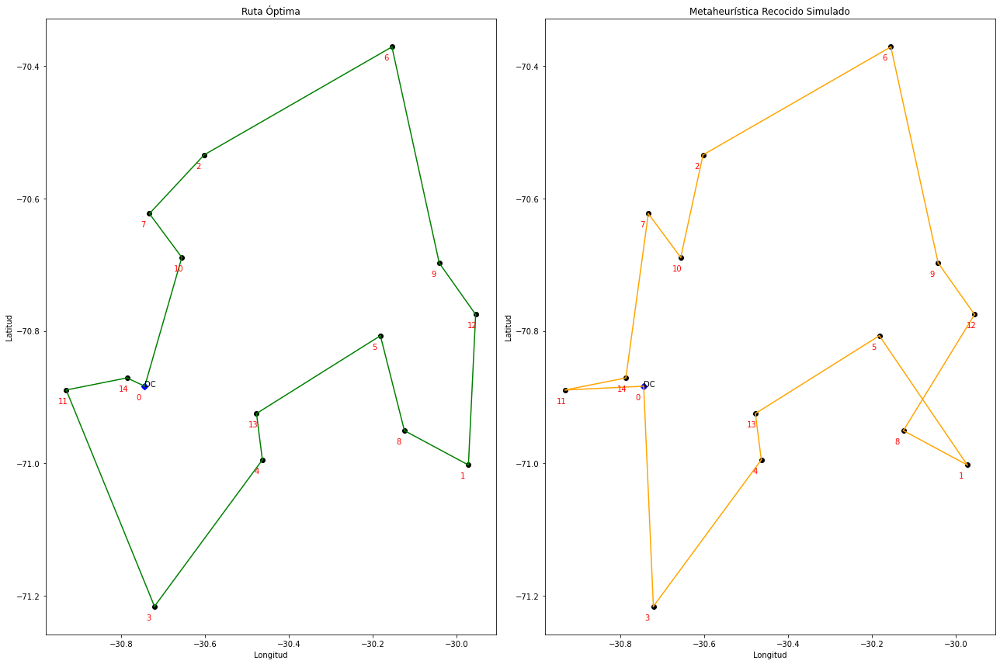

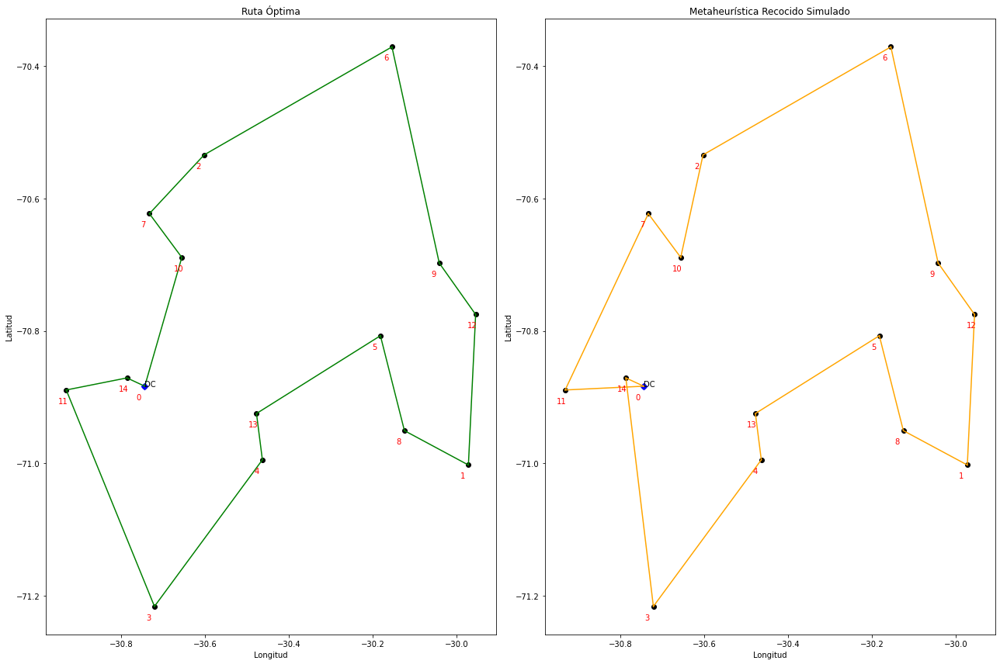

In [24]:
#Ordenar de peor función objetivo a mejor, para que los gráficos vayan mejorando
p_df=pd.DataFrame(resultados,columns=['Modelo','Función Objetivo','Tiempo computacional (segundos)','Ruta','GAP (%)'])
p_df.sort_values(by='Función Objetivo',ascending=False,inplace=True)
p_df.set_index('Modelo',inplace=True)

#Exportar gráficos
g_ruta=list(p_df['Ruta'])

for i in range(len(g_ruta)):
    if i>0 and i<(len(g_ruta)-1):
        gr=gráfico(g_ruta[i])
        gr.savefig('Gráficos\Metaheurística\Gráfico '+str(i)+'.jpg')